In [1]:
from sklearn.cluster import KMeans
import numpy as np
import plotly.express as px
import pandas as pd

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Import DF

In [ ]:
%cd ..

/home/anuar/PycharmProjects/master-thesis


In [3]:
%cd drive/MyDrive/Github/master_thesis

/content/drive/MyDrive/Github/master_thesis


In [4]:
df = pd.read_csv('data/220201_preprocessed_data.csv')
df

,gender,postnr,region,Timings_yyyymmdd,Q1_1_feel_exposed,Q1_2_covid_is_threat,Q2_1_easy_to_follow_advice,Q2_2_can_follow_advice_if_wanted,Q2_3_if_follow_advice_safe,Q2_4_if_follow_advice_others_safe,Q2_5_follow_advice_relationships_impared,Q2_6_follow_advice_life_degraded,Q3_1_aware_hand_hygiene,Q3_2_avoid_contact,Q3_3_ensure_frequent_cleaning,Q3_4_avoid_risk_groups,Q3_5_keep_distance,Q3_6_avoid_crowds,Q3_7_minimize_activities_w_contact,Q3b_1_sneeze_sleeve,Q5_1_others_took_distance,Q5_2_others_follow_advice,Q5_3_others_not_care_spreading,Q5_4_yourself_kept_distance,Q5_5_feel_urge_scold,Q6_1_sanctions_harsh,Q6_2_advices_important,Q6_3_others_can_avoid_spreading,Q6_4_advices_create_fair_burden_dristribution,Q6_5_ownership_of_advice,Q6_6_clear_information_on_advice_reason,Q6_7_advice_limits_daily_activities,Q6_8_advices_enough_for_prevention,Q6_9_trust_plotical_strategy,Ny1_nr_times_wearing_masks_last_week,Q7_1_last_week_fever,Q7_2_last_week_cough,Q7_3_last_week_sore_throat,Q7_4_last_week_no_smell_taste,Q7_5_last_week_shortness_breath,Q2020NovNy1,Q2020NovNy2_tested_positive,Q2020NovNy3,Q2020NovNy4,Q10_education,Q11_nr_members_household,Q12_nr_children_household,Q4_1_nr_contact_nonhouse_family,Q4_2_nr_contact_colleagues,Q4_3_nr_contact_friends,Q4_4_nr_contact_strangers,age_num,Q14_ocupation_pensioner,Q14_ocupation_employee_private,Q14_ocupation_unemployed,Q14_ocupation_employee_public,Q14_ocupation_self_employed,Q14_ocupation_student,Q14_ocupation_other,Q15_economic_spectrum,Q15_social_spectrum,Q16_economic_spectrum,Q16_social_spectrum,Vaccination_Status,Willingness_Vaccination,season,timestamp
0,Man,2830,Capital,20210103,4.0,5.0,5.0,7.0,4.0,7.0,4.0,5.0,6.0,7.0,5.0,7.0,6.0,7.0,7.0,7.0,3.0,5.0,4.0,5.0,1.0,1.0,7.0,5.0,2.0,7.0,7.0,6.0,5.0,6.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,8,1,0,0,0,0,0,6,0,0,0,1,0,0,0,2.0,4.0,4.0,2.0,0.0,1.0,4.0,2021-01-03
1,Woman,4654,Zealand,20200731,3.0,7.0,7.0,7.0,5.0,7.0,6.0,5.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,2.0,3.0,2.0,7.0,1.0,5.0,6.0,5.0,4.0,7.0,6.0,2.0,5.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,0,0,2,2,5,0,0,0,1,0,0,0,2.0,4.0,2.0,4.0,1.0,1.0,2.0,2020-07-31
2,Woman,7451,Central,20210605,3.0,7.0,7.0,7.0,7.0,7.0,4.0,3.0,7.0,7.0,5.0,6.0,7.0,7.0,5.0,7.0,4.0,7.0,5.0,7.0,7.0,4.0,7.0,5.0,4.0,4.0,7.0,2.0,4.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4,1,0,5,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,2.0,4.0,1.0,1.0,2.0,2021-06-05
3,Woman,6740,Southern,20200826,2.0,2.0,3.0,3.0,7.0,7.0,1.0,1.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,3.0,4.0,4.0,7.0,2.0,3.0,7.0,4.0,3.0,7.0,7.0,7.0,7.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,1,0,0,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,3.0,3.0,2.0,1.0,2.0,2020-08-26
4,Man,4700,Zealand,20201106,6.0,6.0,1.0,7.0,2.0,1.0,7.0,4.0,7.0,3.0,7.0,7.0,7.0,7.0,5.0,7.0,2.0,5.0,3.0,7.0,7.0,4.0,7.0,4.0,1.0,1.0,7.0,3.0,7.0,7.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,4,1,4,15,5,1,0,0,0,0,0,0,2.0,3.0,3.0,3.0,1.0,1.0,3.0,2020-11-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125296,Woman,8220,Central,20201129,1.0,6.0,4.0,2.0,4.0,1.0,4.0,4.0,6.0,6.0,5.0,7.0,6.0,6.0,6.0,6.0,4.0,5.0,7.0,7.0,1.0,4.0,6.0,4.0,4.0,7.0,4.0,6.0,4.0,3.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,2,3,3,0,0,0,0,1,0,0,0,0,0,1,0,2.0,4.0,2.0,4.0,1.0,1.0,3.0,2020-11-29
125297,Woman,7400,Central,20210826,4.0,4.0,7.0,7.0,7.0,5.0,6.0,1.0,7.0,4.0,7.0,7.0,7.0,7.0,7.0,7.0,5.0,5.0,3.0,5.0,3.0,4.0,7.0,3.0,5.0,6.0,5.0,1.0,7.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,5,2,0,8,6,5,10,4,0,1,0,0,0,0,0,2.0,3.0,2.0,3.0,2.0,1.0,2.0,2021-08-26
125298,Woman,2400,Capital,20201205,1.0,4.0,5.0,6.0,5.0,5.0,5.0,2.0,5.0,3.0,3.0,5.0,4.0,3.0,6.0,6.0,4.0,5.0,5.0,4.0,2.0,3.0,5.0,5.0,4.0,6.0,3.0,5.0,3.0,5.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,2,4,0,0,0,3,3,1,0,0,0,0,0,1,0,2.0,3.0,2.0,3.0,1.0,1.0,4.0,2020-12-05
125299,Woman,5700,Southe

In [ ]:
df.columns.tolist()

['gender',
 'postnr',
 'region',
 'Timings_yyyymmdd',
 'Q1_1_feel_exposed',
 'Q1_2_covid_is_threat',
 'Q2_1_easy_to_follow_advice',
 'Q2_2_can_follow_advice_if_wanted',
 'Q2_3_if_follow_advice_safe',
 'Q2_4_if_follow_advice_others_safe',
 'Q2_5_follow_advice_relationships_impared',
 'Q2_6_follow_advice_life_degraded',
 'Q3_1_aware_hand_hygiene',
 'Q3_2_avoid_contact',
 'Q3_3_ensure_frequent_cleaning',
 'Q3_4_avoid_risk_groups',
 'Q3_5_keep_distance',
 'Q3_6_avoid_crowds',
 'Q3_7_minimize_activities_w_contact',
 'Q3b_1_sneeze_sleeve',
 'Q5_1_others_took_distance',
 'Q5_2_others_follow_advice',
 'Q5_3_others_not_care_spreading',
 'Q5_4_yourself_kept_distance',
 'Q5_5_feel_urge_scold',
 'Q6_1_sanctions_harsh',
 'Q6_2_advices_important',
 'Q6_3_others_can_avoid_spreading',
 'Q6_4_advices_create_fair_burden_dristribution',
 'Q6_5_ownership_of_advice',
 'Q6_6_clear_information_on_advice_reason',
 'Q6_7_advice_limits_daily_activities',
 'Q6_8_advices_enough_for_prevention',
 'Q6_9_trust_ploti

In [5]:
non_behaviour_cols = ['gender','postnr', 'region', 'Timings_yyyymmdd', 'season','Q10_education', 'Q11_nr_members_household',
 'Q12_nr_children_household','age_num', 'Q14_ocupation_pensioner',
 'Q14_ocupation_employee_private',
 'Q14_ocupation_unemployed',
 'Q14_ocupation_employee_public',
 'Q14_ocupation_self_employed',
 'Q14_ocupation_student',
 'Q14_ocupation_other',
 'Q15_economic_spectrum',
 'Q15_social_spectrum',
 'Q16_economic_spectrum',
 'Q16_social_spectrum',
 'timestamp',  
 'Q7_1_last_week_fever',
 'Q7_2_last_week_cough',
 'Q7_3_last_week_sore_throat',
 'Q7_4_last_week_no_smell_taste',
 'Q7_5_last_week_shortness_breath',
 'Q2020NovNy1',
 'Q2020NovNy2_tested_positive',
 'Q2020NovNy3',
 'Q2020NovNy4']

In [6]:
behaviour_cols = df.columns.tolist()
for element in non_behaviour_cols:
    if element in behaviour_cols:
        behaviour_cols.remove(element)

In [7]:
df.isnull().values.any()

False

In [8]:
answers = df[behaviour_cols].to_numpy()
answers

array([[4., 5., 5., ..., 0., 0., 1.],
       [3., 7., 7., ..., 2., 1., 1.],
       [3., 7., 7., ..., 0., 1., 1.],
       ...,
       [1., 4., 5., ..., 3., 1., 1.],
       [4., 4., 2., ..., 0., 2., 1.],
       [4., 6., 5., ..., 0., 1., 1.]])

In [9]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(data)
answers = scaler.transform(answers)

# K-means fit

In [10]:
distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k)
    kmeanModel.fit(answers)
    distortions.append(kmeanModel.inertia_)

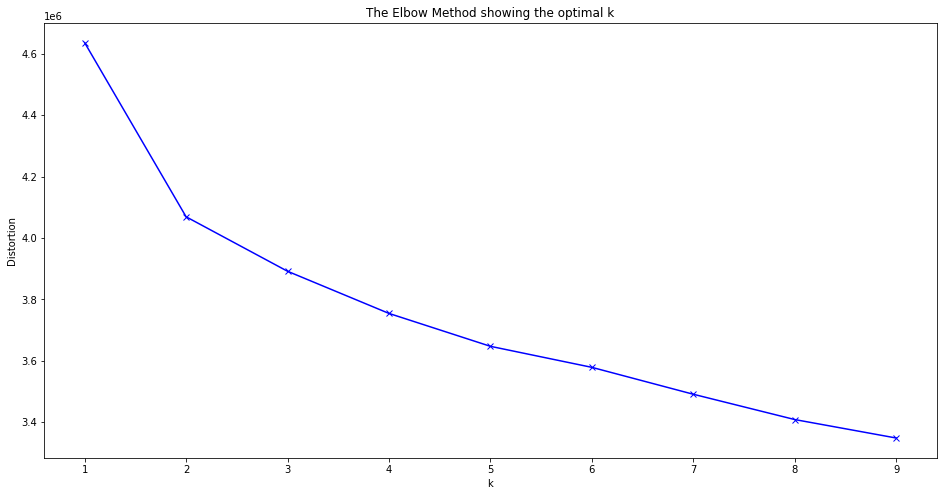

In [11]:
import matplotlib.pyplot as plt

plt.figure(figsize=(16,8))
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

In [12]:
kmeans = KMeans(n_clusters=2, random_state=0).fit(answers)

In [13]:
df['group']=kmeans.labels_

In [14]:
df

,gender,postnr,region,Timings_yyyymmdd,Q1_1_feel_exposed,Q1_2_covid_is_threat,Q2_1_easy_to_follow_advice,Q2_2_can_follow_advice_if_wanted,Q2_3_if_follow_advice_safe,Q2_4_if_follow_advice_others_safe,Q2_5_follow_advice_relationships_impared,Q2_6_follow_advice_life_degraded,Q3_1_aware_hand_hygiene,Q3_2_avoid_contact,Q3_3_ensure_frequent_cleaning,Q3_4_avoid_risk_groups,Q3_5_keep_distance,Q3_6_avoid_crowds,Q3_7_minimize_activities_w_contact,Q3b_1_sneeze_sleeve,Q5_1_others_took_distance,Q5_2_others_follow_advice,Q5_3_others_not_care_spreading,Q5_4_yourself_kept_distance,Q5_5_feel_urge_scold,Q6_1_sanctions_harsh,Q6_2_advices_important,Q6_3_others_can_avoid_spreading,Q6_4_advices_create_fair_burden_dristribution,Q6_5_ownership_of_advice,Q6_6_clear_information_on_advice_reason,Q6_7_advice_limits_daily_activities,Q6_8_advices_enough_for_prevention,Q6_9_trust_plotical_strategy,Ny1_nr_times_wearing_masks_last_week,Q7_1_last_week_fever,Q7_2_last_week_cough,Q7_3_last_week_sore_throat,Q7_4_last_week_no_smell_taste,Q7_5_last_week_shortness_breath,Q2020NovNy1,Q2020NovNy2_tested_positive,Q2020NovNy3,Q2020NovNy4,Q10_education,Q11_nr_members_household,Q12_nr_children_household,Q4_1_nr_contact_nonhouse_family,Q4_2_nr_contact_colleagues,Q4_3_nr_contact_friends,Q4_4_nr_contact_strangers,age_num,Q14_ocupation_pensioner,Q14_ocupation_employee_private,Q14_ocupation_unemployed,Q14_ocupation_employee_public,Q14_ocupation_self_employed,Q14_ocupation_student,Q14_ocupation_other,Q15_economic_spectrum,Q15_social_spectrum,Q16_economic_spectrum,Q16_social_spectrum,Vaccination_Status,Willingness_Vaccination,season,timestamp,group
0,Man,2830,Capital,20210103,4.0,5.0,5.0,7.0,4.0,7.0,4.0,5.0,6.0,7.0,5.0,7.0,6.0,7.0,7.0,7.0,3.0,5.0,4.0,5.0,1.0,1.0,7.0,5.0,2.0,7.0,7.0,6.0,5.0,6.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,8,1,0,0,0,0,0,6,0,0,0,1,0,0,0,2.0,4.0,4.0,2.0,0.0,1.0,4.0,2021-01-03,0
1,Woman,4654,Zealand,20200731,3.0,7.0,7.0,7.0,5.0,7.0,6.0,5.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,2.0,3.0,2.0,7.0,1.0,5.0,6.0,5.0,4.0,7.0,6.0,2.0,5.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,0,0,2,2,5,0,0,0,1,0,0,0,2.0,4.0,2.0,4.0,1.0,1.0,2.0,2020-07-31,0
2,Woman,7451,Central,20210605,3.0,7.0,7.0,7.0,7.0,7.0,4.0,3.0,7.0,7.0,5.0,6.0,7.0,7.0,5.0,7.0,4.0,7.0,5.0,7.0,7.0,4.0,7.0,5.0,4.0,4.0,7.0,2.0,4.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4,1,0,5,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,2.0,4.0,1.0,1.0,2.0,2021-06-05,0
3,Woman,6740,Southern,20200826,2.0,2.0,3.0,3.0,7.0,7.0,1.0,1.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,3.0,4.0,4.0,7.0,2.0,3.0,7.0,4.0,3.0,7.0,7.0,7.0,7.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,1,0,0,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,3.0,3.0,2.0,1.0,2.0,2020-08-26,0
4,Man,4700,Zealand,20201106,6.0,6.0,1.0,7.0,2.0,1.0,7.0,4.0,7.0,3.0,7.0,7.0,7.0,7.0,5.0,7.0,2.0,5.0,3.0,7.0,7.0,4.0,7.0,4.0,1.0,1.0,7.0,3.0,7.0,7.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,4,1,4,15,5,1,0,0,0,0,0,0,2.0,3.0,3.0,3.0,1.0,1.0,3.0,2020-11-06,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125296,Woman,8220,Central,20201129,1.0,6.0,4.0,2.0,4.0,1.0,4.0,4.0,6.0,6.0,5.0,7.0,6.0,6.0,6.0,6.0,4.0,5.0,7.0,7.0,1.0,4.0,6.0,4.0,4.0,7.0,4.0,6.0,4.0,3.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,2,3,3,0,0,0,0,1,0,0,0,0,0,1,0,2.0,4.0,2.0,4.0,1.0,1.0,3.0,2020-11-29,1
125297,Woman,7400,Central,20210826,4.0,4.0,7.0,7.0,7.0,5.0,6.0,1.0,7.0,4.0,7.0,7.0,7.0,7.0,7.0,7.0,5.0,5.0,3.0,5.0,3.0,4.0,7.0,3.0,5.0,6.0,5.0,1.0,7.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,5,2,0,8,6,5,10,4,0,1,0,0,0,0,0,2.0,3.0,2.0,3.0,2.0,1.0,2.0,2021-08-26,0
125298,Woman,2400,Capital,20201205,1.0,4.0,5.0,6.0,5.0,5.0,5.0,2.0,5.0,3.0,3.0,5.0,4.0,3.0,6.0,6.0,4.0,5.0,5.0,4.0,2.0,3.0,5.0,5.0,4.0,6.0,3.0,5.0,3.0,5.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,2,4,0,0,0,3,3,1,0,0,0,0,0,1,0,2.0,3.0,2.0,3.0,1.0,1.0,4.0,2020-12-05,

In [15]:
groups_def = pd.DataFrame(data=scaler.inverse_transform(kmeans.cluster_centers_), columns=behaviour_cols)
groups_def

,Q1_1_feel_exposed,Q1_2_covid_is_threat,Q2_1_easy_to_follow_advice,Q2_2_can_follow_advice_if_wanted,Q2_3_if_follow_advice_safe,Q2_4_if_follow_advice_others_safe,Q2_5_follow_advice_relationships_impared,Q2_6_follow_advice_life_degraded,Q3_1_aware_hand_hygiene,Q3_2_avoid_contact,Q3_3_ensure_frequent_cleaning,Q3_4_avoid_risk_groups,Q3_5_keep_distance,Q3_6_avoid_crowds,Q3_7_minimize_activities_w_contact,Q3b_1_sneeze_sleeve,Q5_1_others_took_distance,Q5_2_others_follow_advice,Q5_3_others_not_care_spreading,Q5_4_yourself_kept_distance,Q5_5_feel_urge_scold,Q6_1_sanctions_harsh,Q6_2_advices_important,Q6_3_others_can_avoid_spreading,Q6_4_advices_create_fair_burden_dristribution,Q6_5_ownership_of_advice,Q6_6_clear_information_on_advice_reason,Q6_7_advice_limits_daily_activities,Q6_8_advices_enough_for_prevention,Q6_9_trust_plotical_strategy,Ny1_nr_times_wearing_masks_last_week,Q4_1_nr_contact_nonhouse_family,Q4_2_nr_contact_colleagues,Q4_3_nr_contact_friends,Q4_4_nr_contact_strangers,Vaccination_Status,Willingness_Vaccination
0,3.286402,5.184757,5.918761,6.378036,5.924951,6.468058,4.242762,3.241844,6.684447,6.213685,5.708835,6.535986,6.296177,6.192237,5.914680,6.688243,4.678455,5.096373,3.562384,6.355199,2.934540,3.112772,6.470563,4.754087,4.863609,6.219131,5.914469,4.284802,5.468976,5.692609,2.023209,1.419977,1.255526,1.411715,2.141898,1.090270,0.994219
1,2.798174,4.099313,4.635442,5.270974,4.525835,5.243203,4.367937,3.876787,5.614922,4.271690,4.161971,5.103184,4.422091,4.196746,3.879562,6.041354,3.586166,4.139011,3.523038,4.910086,2.215924,3.518361,4.805044,4.103945,3.632354,4.522479,4.114888,4.103654,4.381587,3.827198,1.740282,1.851299,2.346029,2.601696,4.023251,1.126793,0.967753


# Groups daily distribution

In [16]:
groups_percentage = df.groupby(['timestamp','group'],as_index=False)['gender'].count()
groups_percentage

,timestamp,group,gender
0,2020-05-29,0,37
1,2020-05-29,1,17
2,2020-05-30,0,225
3,2020-05-30,1,88
4,2020-05-31,0,137
...,...,...,...
1099,2021-11-29,1,46
1100,2021-11-30,0,88
1101,2021-11-30,1,51
1102,2021-12-01,0,84


In [17]:
def normalize(row):
  sum = groups_percentage[groups_percentage['timestamp']==row['timestamp']]['gender'].sum()
  return row['gender']/sum
groups_percentage['percentage'] = groups_percentage.apply(lambda x: normalize(x), axis=1)

In [18]:
groups_percentage.drop(columns='gender',inplace=True)

In [19]:
groups_percentage

,timestamp,group,percentage
0,2020-05-29,0,0.685185
1,2020-05-29,1,0.314815
2,2020-05-30,0,0.718850
3,2020-05-30,1,0.281150
4,2020-05-31,0,0.637209
...,...,...,...
1099,2021-11-29,1,0.386555
1100,2021-11-30,0,0.633094
1101,2021-11-30,1,0.366906
1102,2021-12-01,0,0.567568


In [ ]:
# for pandas version "1.4.0, we pray for the day colab updates"
'''groups_per_day = df[['timestamp','group']].groupby(['timestamp']).value_counts(normalize=True)
groups_percentage = groups_per_day.index.to_frame(index=False)
groups_percentage['percentage'] = groups_per_day.values
groups_percentage'''

"groups_per_day = df[['timestamp','group']].groupby(['timestamp']).value_counts(normalize=True)\ngroups_percentage = groups_per_day.index.to_frame(index=False)\ngroups_percentage['percentage'] = groups_per_day.values\ngroups_percentage"

In [20]:
fig = px.line(groups_percentage, x="timestamp", y="percentage", color='group', title='Group daily distribution')
fig.show()

![image](/content/drive/MyDrive/Github/master_thesis/data/coronavirus-data-explorer.png)

<img src="/data/coronavirus-data-explorer.png" alt="drawing"/>

# Group Analysis

In [21]:
group_analysis = df[non_behaviour_cols+['group','timestamp']].copy()
group_analysis

,gender,postnr,region,Timings_yyyymmdd,season,Q10_education,Q11_nr_members_household,Q12_nr_children_household,age_num,Q14_ocupation_pensioner,Q14_ocupation_employee_private,Q14_ocupation_unemployed,Q14_ocupation_employee_public,Q14_ocupation_self_employed,Q14_ocupation_student,Q14_ocupation_other,Q15_economic_spectrum,Q15_social_spectrum,Q16_economic_spectrum,Q16_social_spectrum,timestamp,Q7_1_last_week_fever,Q7_2_last_week_cough,Q7_3_last_week_sore_throat,Q7_4_last_week_no_smell_taste,Q7_5_last_week_shortness_breath,Q2020NovNy1,Q2020NovNy2_tested_positive,Q2020NovNy3,Q2020NovNy4,group,timestamp
0,Man,2830,Capital,20210103,4.0,8,1,0,6,0,0,0,1,0,0,0,2.0,4.0,4.0,2.0,2021-01-03,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,2021-01-03
1,Woman,4654,Zealand,20200731,2.0,3,1,0,5,0,0,0,1,0,0,0,2.0,4.0,2.0,4.0,2020-07-31,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,2020-07-31
2,Woman,7451,Central,20210605,2.0,4,1,0,5,0,0,0,1,0,0,0,2.0,3.0,2.0,4.0,2021-06-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,2021-06-05
3,Woman,6740,Southern,20200826,2.0,1,1,0,5,0,0,0,1,0,0,0,2.0,3.0,3.0,3.0,2020-08-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,2020-08-26
4,Man,4700,Zealand,20201106,3.0,3,1,0,5,1,0,0,0,0,0,0,2.0,3.0,3.0,3.0,2020-11-06,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,2020-11-06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125296,Woman,8220,Central,20201129,3.0,2,3,3,1,0,0,0,0,0,1,0,2.0,4.0,2.0,4.0,2020-11-29,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,1,2020-11-29
125297,Woman,7400,Central,20210826,2.0,5,2,0,4,0,1,0,0,0,0,0,2.0,3.0,2.0,3.0,2021-08-26,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0,2021-08-26
125298,Woman,2400,Capital,20201205,4.0,2,4,0,1,0,0,0,0,0,1,0,2.0,3.0,2.0,3.0,2020-12-05,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,2020-12-05
125299,Woman,5700,Southern,20210828,2.0,3,3,1,3,0,1,0,0,0,0,0,3.0,2.0,3.0,2.0,2021-08-28,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,2021-08-28


In [22]:
groups_def

,Q1_1_feel_exposed,Q1_2_covid_is_threat,Q2_1_easy_to_follow_advice,Q2_2_can_follow_advice_if_wanted,Q2_3_if_follow_advice_safe,Q2_4_if_follow_advice_others_safe,Q2_5_follow_advice_relationships_impared,Q2_6_follow_advice_life_degraded,Q3_1_aware_hand_hygiene,Q3_2_avoid_contact,Q3_3_ensure_frequent_cleaning,Q3_4_avoid_risk_groups,Q3_5_keep_distance,Q3_6_avoid_crowds,Q3_7_minimize_activities_w_contact,Q3b_1_sneeze_sleeve,Q5_1_others_took_distance,Q5_2_others_follow_advice,Q5_3_others_not_care_spreading,Q5_4_yourself_kept_distance,Q5_5_feel_urge_scold,Q6_1_sanctions_harsh,Q6_2_advices_important,Q6_3_others_can_avoid_spreading,Q6_4_advices_create_fair_burden_dristribution,Q6_5_ownership_of_advice,Q6_6_clear_information_on_advice_reason,Q6_7_advice_limits_daily_activities,Q6_8_advices_enough_for_prevention,Q6_9_trust_plotical_strategy,Ny1_nr_times_wearing_masks_last_week,Q4_1_nr_contact_nonhouse_family,Q4_2_nr_contact_colleagues,Q4_3_nr_contact_friends,Q4_4_nr_contact_strangers,Vaccination_Status,Willingness_Vaccination
0,3.286402,5.184757,5.918761,6.378036,5.924951,6.468058,4.242762,3.241844,6.684447,6.213685,5.708835,6.535986,6.296177,6.192237,5.914680,6.688243,4.678455,5.096373,3.562384,6.355199,2.934540,3.112772,6.470563,4.754087,4.863609,6.219131,5.914469,4.284802,5.468976,5.692609,2.023209,1.419977,1.255526,1.411715,2.141898,1.090270,0.994219
1,2.798174,4.099313,4.635442,5.270974,4.525835,5.243203,4.367937,3.876787,5.614922,4.271690,4.161971,5.103184,4.422091,4.196746,3.879562,6.041354,3.586166,4.139011,3.523038,4.910086,2.215924,3.518361,4.805044,4.103945,3.632354,4.522479,4.114888,4.103654,4.381587,3.827198,1.740282,1.851299,2.346029,2.601696,4.023251,1.126793,0.967753


In [23]:
group_analysis.groupby(['group']).mean()

,postnr,Timings_yyyymmdd,season,Q10_education,Q11_nr_members_household,Q12_nr_children_household,age_num,Q14_ocupation_pensioner,Q14_ocupation_employee_private,Q14_ocupation_unemployed,Q14_ocupation_employee_public,Q14_ocupation_self_employed,Q14_ocupation_student,Q14_ocupation_other,Q15_economic_spectrum,Q15_social_spectrum,Q16_economic_spectrum,Q16_social_spectrum,Q7_1_last_week_fever,Q7_2_last_week_cough,Q7_3_last_week_sore_throat,Q7_4_last_week_no_smell_taste,Q7_5_last_week_shortness_breath,Q2020NovNy1,Q2020NovNy2_tested_positive,Q2020NovNy3,Q2020NovNy4
group,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,5658.955525,2.020539e+07,2.557509,4.085677,1.802479,0.547419,3.884946,0.284066,0.214874,0.032860,0.335792,0.049086,0.049173,0.034149,2.386712,3.403595,2.457998,3.318686,0.017056,0.076839,0.065435,0.016374,0.016535,0.013709,0.003099,0.025894,2.771305
1,5585.772801,2.020590e+07,2.441783,4.210527,1.918837,0.712836,2.945279,0.376910,0.223009,0.031708,0.153453,0.061735,0.115381,0.037803,2.554968,3.310581,2.672254,3.144109,0.023753,0.113947,0.098015,0.021535,0.020974,0.017680,0.002532,0.022319,2.767759


In [24]:
df

,gender,postnr,region,Timings_yyyymmdd,Q1_1_feel_exposed,Q1_2_covid_is_threat,Q2_1_easy_to_follow_advice,Q2_2_can_follow_advice_if_wanted,Q2_3_if_follow_advice_safe,Q2_4_if_follow_advice_others_safe,Q2_5_follow_advice_relationships_impared,Q2_6_follow_advice_life_degraded,Q3_1_aware_hand_hygiene,Q3_2_avoid_contact,Q3_3_ensure_frequent_cleaning,Q3_4_avoid_risk_groups,Q3_5_keep_distance,Q3_6_avoid_crowds,Q3_7_minimize_activities_w_contact,Q3b_1_sneeze_sleeve,Q5_1_others_took_distance,Q5_2_others_follow_advice,Q5_3_others_not_care_spreading,Q5_4_yourself_kept_distance,Q5_5_feel_urge_scold,Q6_1_sanctions_harsh,Q6_2_advices_important,Q6_3_others_can_avoid_spreading,Q6_4_advices_create_fair_burden_dristribution,Q6_5_ownership_of_advice,Q6_6_clear_information_on_advice_reason,Q6_7_advice_limits_daily_activities,Q6_8_advices_enough_for_prevention,Q6_9_trust_plotical_strategy,Ny1_nr_times_wearing_masks_last_week,Q7_1_last_week_fever,Q7_2_last_week_cough,Q7_3_last_week_sore_throat,Q7_4_last_week_no_smell_taste,Q7_5_last_week_shortness_breath,Q2020NovNy1,Q2020NovNy2_tested_positive,Q2020NovNy3,Q2020NovNy4,Q10_education,Q11_nr_members_household,Q12_nr_children_household,Q4_1_nr_contact_nonhouse_family,Q4_2_nr_contact_colleagues,Q4_3_nr_contact_friends,Q4_4_nr_contact_strangers,age_num,Q14_ocupation_pensioner,Q14_ocupation_employee_private,Q14_ocupation_unemployed,Q14_ocupation_employee_public,Q14_ocupation_self_employed,Q14_ocupation_student,Q14_ocupation_other,Q15_economic_spectrum,Q15_social_spectrum,Q16_economic_spectrum,Q16_social_spectrum,Vaccination_Status,Willingness_Vaccination,season,timestamp,group
0,Man,2830,Capital,20210103,4.0,5.0,5.0,7.0,4.0,7.0,4.0,5.0,6.0,7.0,5.0,7.0,6.0,7.0,7.0,7.0,3.0,5.0,4.0,5.0,1.0,1.0,7.0,5.0,2.0,7.0,7.0,6.0,5.0,6.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,8,1,0,0,0,0,0,6,0,0,0,1,0,0,0,2.0,4.0,4.0,2.0,0.0,1.0,4.0,2021-01-03,0
1,Woman,4654,Zealand,20200731,3.0,7.0,7.0,7.0,5.0,7.0,6.0,5.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,2.0,3.0,2.0,7.0,1.0,5.0,6.0,5.0,4.0,7.0,6.0,2.0,5.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,0,0,2,2,5,0,0,0,1,0,0,0,2.0,4.0,2.0,4.0,1.0,1.0,2.0,2020-07-31,0
2,Woman,7451,Central,20210605,3.0,7.0,7.0,7.0,7.0,7.0,4.0,3.0,7.0,7.0,5.0,6.0,7.0,7.0,5.0,7.0,4.0,7.0,5.0,7.0,7.0,4.0,7.0,5.0,4.0,4.0,7.0,2.0,4.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,4,1,0,5,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,2.0,4.0,1.0,1.0,2.0,2021-06-05,0
3,Woman,6740,Southern,20200826,2.0,2.0,3.0,3.0,7.0,7.0,1.0,1.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,7.0,3.0,4.0,4.0,7.0,2.0,3.0,7.0,4.0,3.0,7.0,7.0,7.0,7.0,7.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,1,1,0,0,0,0,0,5,0,0,0,1,0,0,0,2.0,3.0,3.0,3.0,2.0,1.0,2.0,2020-08-26,0
4,Man,4700,Zealand,20201106,6.0,6.0,1.0,7.0,2.0,1.0,7.0,4.0,7.0,3.0,7.0,7.0,7.0,7.0,5.0,7.0,2.0,5.0,3.0,7.0,7.0,4.0,7.0,4.0,1.0,1.0,7.0,3.0,7.0,7.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,3,1,0,4,1,4,15,5,1,0,0,0,0,0,0,2.0,3.0,3.0,3.0,1.0,1.0,3.0,2020-11-06,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125296,Woman,8220,Central,20201129,1.0,6.0,4.0,2.0,4.0,1.0,4.0,4.0,6.0,6.0,5.0,7.0,6.0,6.0,6.0,6.0,4.0,5.0,7.0,7.0,1.0,4.0,6.0,4.0,4.0,7.0,4.0,6.0,4.0,3.0,4.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,3.0,2,3,3,0,0,0,0,1,0,0,0,0,0,1,0,2.0,4.0,2.0,4.0,1.0,1.0,3.0,2020-11-29,1
125297,Woman,7400,Central,20210826,4.0,4.0,7.0,7.0,7.0,5.0,6.0,1.0,7.0,4.0,7.0,7.0,7.0,7.0,7.0,7.0,5.0,5.0,3.0,5.0,3.0,4.0,7.0,3.0,5.0,6.0,5.0,1.0,7.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,5,2,0,8,6,5,10,4,0,1,0,0,0,0,0,2.0,3.0,2.0,3.0,2.0,1.0,2.0,2021-08-26,0
125298,Woman,2400,Capital,20201205,1.0,4.0,5.0,6.0,5.0,5.0,5.0,2.0,5.0,3.0,3.0,5.0,4.0,3.0,6.0,6.0,4.0,5.0,5.0,4.0,2.0,3.0,5.0,5.0,4.0,6.0,3.0,5.0,3.0,5.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,2,4,0,0,0,3,3,1,0,0,0,0,0,1,0,2.0,3.0,2.0,3.0,1.0,1.0,4.0,2020-12-05,

In [33]:
df.columns

Index(['gender', 'postnr', 'region', 'Timings_yyyymmdd', 'Q1_1_feel_exposed',
       'Q1_2_covid_is_threat', 'Q2_1_easy_to_follow_advice',
       'Q2_2_can_follow_advice_if_wanted', 'Q2_3_if_follow_advice_safe',
       'Q2_4_if_follow_advice_others_safe',
       'Q2_5_follow_advice_relationships_impared',
       'Q2_6_follow_advice_life_degraded', 'Q3_1_aware_hand_hygiene',
       'Q3_2_avoid_contact', 'Q3_3_ensure_frequent_cleaning',
       'Q3_4_avoid_risk_groups', 'Q3_5_keep_distance', 'Q3_6_avoid_crowds',
       'Q3_7_minimize_activities_w_contact', 'Q3b_1_sneeze_sleeve',
       'Q5_1_others_took_distance', 'Q5_2_others_follow_advice',
       'Q5_3_others_not_care_spreading', 'Q5_4_yourself_kept_distance',
       'Q5_5_feel_urge_scold', 'Q6_1_sanctions_harsh',
       'Q6_2_advices_important', 'Q6_3_others_can_avoid_spreading',
       'Q6_4_advices_create_fair_burden_dristribution',
       'Q6_5_ownership_of_advice', 'Q6_6_clear_information_on_advice_reason',
       'Q6_7_advice_lim

In [34]:
for i in df.columns:
  fig = px.box(df,color='group', y=i)
  fig.show()